<a href="https://colab.research.google.com/github/aln21-ua/TFM-PINNs/blob/main/Implementacion/Ecuacion%20Korteweg-De%20Vries/Comparativa.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Librerías

In [ ]:
# Cálculo numérico
import numpy as np

# Representación y animación
import matplotlib.pyplot as plt
import matplotlib.animation as animation

# Visualización de la animación en Colab
from IPython.display import HTML

# Guardar archivos en drive
mountdrive = True
if mountdrive==True:
  from google.colab import drive
  drive.mount('/content/drive')

Mounted at /content/drive


# Info

In [ ]:
# Longitud de la cuerda
L = 20.0

# Tiempo máximo de simulación
T = 2.0

# Discretización espacial y temporal
Nx = 51  # Número de puntos espaciales
Nt = 61  # Número de puntos temporales
x = np.linspace(0, L, Nx)
t = np.linspace(0, T, Nt)

# Cargar datos

In [ ]:
TFM_route = "/content/drive/MyDrive/TFM/Implementacion/"
simulation_name = "Ecuacion Korteweg-De Vries/"

if mountdrive == True:
  TFM_route = "/content/drive/MyDrive/TFM/Implementacion/"
  simulation_name = "Ecuacion Korteweg-De Vries/Matrices/"
  u_tx_real = np.load(TFM_route+simulation_name+"u_tx_real.npy")
  u_tx_PINN = np.load(TFM_route+simulation_name+"u_tx_PINN-.npy")
  u_tx_PINN_Datos = np.load(TFM_route+simulation_name+"u_tx_PINN_datos-.npy")
  u_tx_NN_Datos = np.load(TFM_route+simulation_name+"u_tx_NN_datos-.npy")
  u_tx_PINNsFormer = np.load(TFM_route+simulation_name+"u_tx_PINNsFormer-.npy")
  u_tx_PINNsFormer_Datos = np.load(TFM_route+simulation_name+"u_tx_PINNsFormer_datos-.npy")
  u_tx_Transformer_Datos = np.load(TFM_route+simulation_name+"u_tx_Transformer_datos-.npy")
else:
  u_tx_real = np.load("u_tx_real.npy")
  u_tx_PINN = np.load("u_tx_PINN-.npy")
  u_tx_PINN_Datos = np.load("u_tx_PINN_datos-.npy")
  u_tx_NN_Datos = np.load("u_tx_NN_datos-.npy")
  u_tx_PINNsFormer = np.load("u_tx_PINNsFormer-.npy")
  u_tx_PINNsFormer_Datos = np.load("u_tx_PINNsFormer_datos-.npy")
  u_tx_Transformer_Datos = np.load("u_tx_Transformer_datos-.npy")



In [ ]:
def AE(u_tx):
  return np.abs(u_tx_real-u_tx)

# Significancia estadistica

In [ ]:
print(u_tx_PINN.shape, u_tx_PINN_Datos.shape,u_tx_NN_Datos.shape,u_tx_PINNsFormer.shape,u_tx_PINNsFormer_Datos.shape,u_tx_Transformer_Datos.shape)

(5, 61, 51) (5, 61, 51) (5, 61, 51) (5, 61, 51) (5, 61, 51) (5, 61, 51)


## MAE de cada simulación

In [ ]:
def MAE_list(u_tx_list):
  lista = []
  for u_tx in u_tx_list:
    lista.append(np.mean(AE(u_tx)))
  return lista

In [ ]:
MAE_dict = {
            'PINN': MAE_list(u_tx_PINN),
            'PINN_Datos': MAE_list(u_tx_PINN_Datos),
            'NN_Datos': MAE_list(u_tx_NN_Datos),
            'PINNsFormer': MAE_list(u_tx_PINNsFormer),
            'PINNsFormer_Datos': MAE_list(u_tx_PINNsFormer_Datos),
            'Transformer_Datos': MAE_list(u_tx_Transformer_Datos)
            }
MAE_dict

{'PINN': [0.046031517137013575,
  0.02470900495311681,
  0.01827620597204353,
  0.04419484768769697,
  0.012412212433980118],
 'PINN_Datos': [0.0022828042534026823,
  0.0015024872209439104,
  0.002619360791321225,
  0.0017422101188661302,
  0.0015072795351664184],
 'NN_Datos': [0.08538501457446152,
  0.0448661656266675,
  0.2093271294284498,
  0.051215214932064206,
  0.07153045896283904],
 'PINNsFormer': [0.002481342853720846,
  0.0019349554852238775,
  0.0011535769352720342,
  0.00314586503952716,
  0.0014716837116566799],
 'PINNsFormer_Datos': [0.00018289787708516365,
  0.00023762853038945074,
  0.00020272780800061676,
  0.00021052654601773712,
  0.000390871502280815],
 'Transformer_Datos': [0.04937572800200232,
  0.07635492163957747,
  0.04320248260341924,
  0.03954770556620813,
  0.06096990446206402]}

In [ ]:
print("##### MAE MEDIO #####")
MAE_medio = {}
for model in MAE_dict:
  MAE_medio[model] = round(np.mean(np.array(MAE_dict[model])),4)

MAE_medio

##### MAE MEDIO #####


{'PINN': 0.0291,
 'PINN_Datos': 0.0019,
 'NN_Datos': 0.0925,
 'PINNsFormer': 0.002,
 'PINNsFormer_Datos': 0.0002,
 'Transformer_Datos': 0.0539}

## MAE de la solución media

In [ ]:
def MAE_sol(u_tx_list):
  return round(np.mean(AE(np.mean(u_tx_list, axis=0))),4)


In [ ]:
MAE_sol_media = {'PINN': MAE_sol(u_tx_PINN),
                 'PINN_Datos': MAE_sol(u_tx_PINN_Datos),
                 'NN_Datos': MAE_sol(u_tx_NN_Datos),
                 'PINNsFormer': MAE_sol(u_tx_PINNsFormer),
                 'PINNsFormer_Datos': MAE_sol(u_tx_PINNsFormer_Datos),
                 'Transformer_Datos': MAE_sol(u_tx_Transformer_Datos)
                 }
print("##### MAE de la solución media #####")
MAE_sol_media

##### MAE de la solución media #####


{'PINN': 0.0257,
 'PINN_Datos': 0.0014,
 'NN_Datos': 0.0652,
 'PINNsFormer': 0.0016,
 'PINNsFormer_Datos': 0.0001,
 'Transformer_Datos': 0.0443}

## $\sigma$ del AE la solución media

In [ ]:
def std_AE_sol(u_tx_list):
  return round(np.std(AE(np.mean(u_tx_list, axis=0))),4)


In [ ]:
std_AE_sol_media = {'PINN': std_AE_sol(u_tx_PINN),
                    'PINN_Datos': std_AE_sol(u_tx_PINN_Datos),
                    'NN_Datos': std_AE_sol(u_tx_NN_Datos),
                    'PINNsFormer': std_AE_sol(u_tx_PINNsFormer),
                    'PINNsFormer_Datos': std_AE_sol(u_tx_PINNsFormer_Datos),
                    'Transformer_Datos': std_AE_sol(u_tx_Transformer_Datos)
                 }
print("##### STD del error absoluto de la solución media #####")
std_AE_sol_media

##### STD del error absoluto de la solución media #####


{'PINN': 0.038,
 'PINN_Datos': 0.0014,
 'NN_Datos': 0.2631,
 'PINNsFormer': 0.0038,
 'PINNsFormer_Datos': 0.0001,
 'Transformer_Datos': 0.1209}

## $E_\max$ del AE la solución media

In [ ]:
def Emax_AE_sol(u_tx_list):
  return round(np.max(AE(np.mean(u_tx_list, axis=0))),3)


In [ ]:
Emax_AE_sol_media = {'PINN': Emax_AE_sol(u_tx_PINN),
                     'PINN_Datos': Emax_AE_sol(u_tx_PINN_Datos),
                     'NN_Datos': Emax_AE_sol(u_tx_NN_Datos),
                     'PINNsFormer': Emax_AE_sol(u_tx_PINNsFormer),
                     'PINNsFormer_Datos': Emax_AE_sol(u_tx_PINNsFormer_Datos),
                     'Transformer_Datos': Emax_AE_sol(u_tx_Transformer_Datos)
                 }
print("##### Maximo del error absoluto de la solución media #####")
Emax_AE_sol_media

##### Maximo del error absoluto de la solución media #####


{'PINN': 0.255,
 'PINN_Datos': 0.013,
 'NN_Datos': 5.078,
 'PINNsFormer': 0.053,
 'PINNsFormer_Datos': 0.001,
 'Transformer_Datos': 1.452}

In [ ]:
print("Modelo   MAE medio   MAE sol media   std AE sol media    AEmax sol media")
for model in MAE_dict:
  print(f"{model}   {MAE_medio[model]}    {MAE_sol_media[model]}   {std_AE_sol_media[model]}    {Emax_AE_sol_media[model]}")

Modelo   MAE medio   MAE sol media   std AE sol media    AEmax sol media
PINN   0.0291    0.0257   0.038    0.255
PINN_Datos   0.0019    0.0014   0.0014    0.013
NN_Datos   0.0925    0.0652   0.2631    5.078
PINNsFormer   0.002    0.0016   0.0038    0.053
PINNsFormer_Datos   0.0002    0.0001   0.0001    0.001
Transformer_Datos   0.0539    0.0443   0.1209    1.452


## Test ANOVA

In [ ]:
import scipy.stats as stats
stats.f_oneway(*tuple(MAE_dict.values()))

F_onewayResult(statistic=8.339015622734989, pvalue=0.00011064594688217946)

## Test t de Student

In [ ]:
comparedict = {}
for i in range(len(MAE_dict.keys())-1):
  comparedict[list(MAE_dict.keys())[i]] = list(MAE_dict.keys())[i+1:]
comparedict

{'PINN': ['PINN_Datos',
  'NN_Datos',
  'PINNsFormer',
  'PINNsFormer_Datos',
  'Transformer_Datos'],
 'PINN_Datos': ['NN_Datos',
  'PINNsFormer',
  'PINNsFormer_Datos',
  'Transformer_Datos'],
 'NN_Datos': ['PINNsFormer', 'PINNsFormer_Datos', 'Transformer_Datos'],
 'PINNsFormer': ['PINNsFormer_Datos', 'Transformer_Datos'],
 'PINNsFormer_Datos': ['Transformer_Datos']}

In [ ]:
for model1 in comparedict:
  for model2 in comparedict[model1]:
    t_stat, p_value = stats.ttest_ind(MAE_dict[model1], MAE_dict[model2])
    ojo =' '
    if p_value>=0.05:
      ojo = "! "
    print(ojo+f"{model1} vs. {model2} --- p-value: {round(p_value,5)}")#, t-statistic: {t_stat}")

 PINN vs. PINN_Datos --- p-value: 0.00402
! PINN vs. NN_Datos --- p-value: 0.07419
 PINN vs. PINNsFormer --- p-value: 0.00413
 PINN vs. PINNsFormer_Datos --- p-value: 0.00285
 PINN vs. Transformer_Datos --- p-value: 0.03197
 PINN_Datos vs. NN_Datos --- p-value: 0.01686
! PINN_Datos vs. PINNsFormer --- p-value: 0.8061
 PINN_Datos vs. PINNsFormer_Datos --- p-value: 7e-05
 PINN_Datos vs. Transformer_Datos --- p-value: 5e-05
 NN_Datos vs. PINNsFormer --- p-value: 0.01695
 NN_Datos vs. PINNsFormer_Datos --- p-value: 0.01548
! NN_Datos vs. Transformer_Datos --- p-value: 0.24618
 PINNsFormer vs. PINNsFormer_Datos --- p-value: 0.00105
 PINNsFormer vs. Transformer_Datos --- p-value: 6e-05
 PINNsFormer_Datos vs. Transformer_Datos --- p-value: 4e-05


# Cálculos de comparativas

## Error absoluto

In [ ]:
def AE(u_tx):
  return np.abs(u_tx_real-u_tx)

## Mapa de calor

In [ ]:
size = 20
def ErrorHeatMap(u_tx, title):
  error_abs_tx = AE(u_tx)
  rMAE = np.sum(error_abs_tx) / np.sum(np.abs(u_tx_real))
  rRMSE = np.sqrt(np.sum(error_abs_tx**2) / np.sum(u_tx_real**2))
  print("rMAE = {:.3f}".format(rMAE))
  print("rRMSE = {:.3f}".format(rRMSE))
  print("Emax = {:.3f}".format(np.max(error_abs_tx)))
  plt.figure(figsize=(6, 2))
  plt.imshow(error_abs_tx[:,::-1].T, extent=[np.min(t), np.max(t), np.min(x), np.max(x)], aspect='auto', interpolation='nearest', cmap = "inferno", vmin=0)#, vmax=0.05)#, vmax = 0.06)#min([np.max(error_abs_tx), 0.06]))
  cbar = plt.colorbar(label='AE(x,t)')
  cbar.ax.tick_params(labelsize=size)
  cbar.set_label('AE(x,t)', fontsize=size)
  cbar.set_ticks(np.round(np.linspace(0,np.max(error_abs_tx),5),4))
  #cbar.set_ticks(np.round(np.linspace(0,0.05,6),2))
  plt.xlabel('t', fontsize=size)
  plt.ylabel('x', fontsize=size)
  plt.ylim([0,L])
  plt.xticks(np.linspace(0,T,5), fontsize=size)
  plt.yticks(np.linspace(0,L,5),fontsize=size)
  plt.title('Error: '+ title, fontsize=size)
  plt.show()

In [ ]:
def HeatMap(u_tx, title):
  #print("rMAE = {:.3f}".format(rMAE))
  #print("rRMSE = {:.3f}".format(rRMSE))
  plt.figure(figsize=(6, 2))
  plt.imshow(u_tx[:,::-1].T, extent=[np.min(t), np.max(t), np.min(x), np.max(x)], aspect='auto', interpolation='nearest', cmap = "inferno")#, vmin=-1, vmax=1)
  cbar = plt.colorbar(label='u(x,t)')
  cbar.ax.tick_params(labelsize=size)
  cbar.set_label('u(x,t)', fontsize=size)
  cbar.set_ticks(np.round(np.linspace(np.min(u_tx),np.max(u_tx),5),1))
  plt.xlabel('t', fontsize=size)
  plt.ylabel('x', fontsize=size)
  plt.ylim([0,L])
  plt.xticks(np.linspace(0,T,5), fontsize=size)
  plt.yticks(np.linspace(0,L,5),fontsize=size)
  plt.title(title, fontsize=size)
  plt.show()

## Animación

In [ ]:
size=25
def AnimComparacion(u_tx, title):
  fig, ax = plt.subplots()
  ax.set_xlim(0, L)
  ax.set_ylim(np.min(u_tx)-.5, np.max(u_tx)+.5)
  ax.set_xlabel('x', fontsize=size)
  ax.set_ylabel('u(x,t)', fontsize=size)
  ax.tick_params(axis='both', which='major', labelsize=size)
  ax.set_title(title, fontsize=size)

  # Imagen inicial
  line_real, = ax.plot(x, u_tx_real[0], label="Solución analítica")
  line, = ax.plot(x, u_tx[0], color="tab:purple", label = title)
  tiempo_text = ax.text(0.95, 0.95, '', transform=ax.transAxes, ha='right', va='top', fontsize=size)
  legend = ax.legend(loc="lower left", fontsize=12)

  def actualizar(frame):
    line_real.set_ydata(u_tx_real[frame])
    line.set_ydata(u_tx[frame])
    tiempo_text.set_text(f't: {t[frame]:.2f}')
    return line_real, line, tiempo_text, legend

  # Actualizar
  ani = animation.FuncAnimation(fig, actualizar, frames=Nt, interval=50, blit=True)

  # Mostrar la animación en Google Colab
  plt.close("all")
  return HTML(ani.to_jshtml())

# Análisis de los resultados

## Mapa de calor

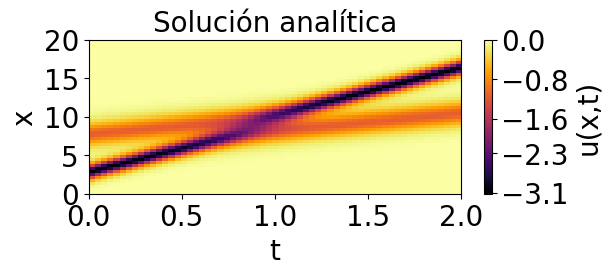

In [ ]:
HeatMap(u_tx_real, "Solución analítica")

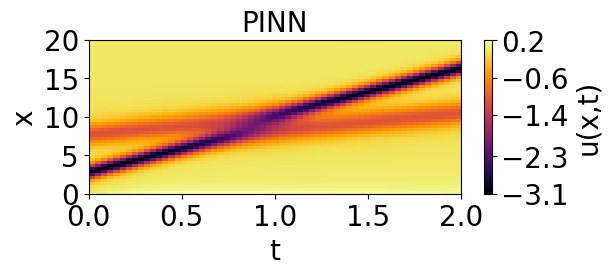

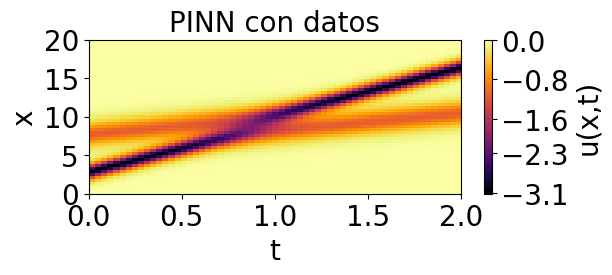

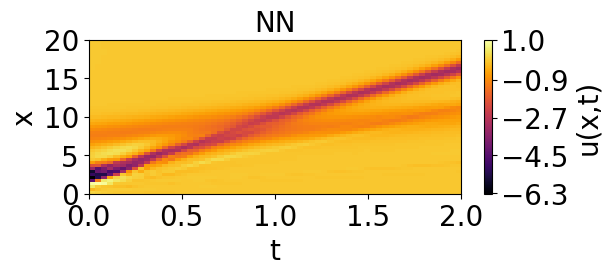

In [ ]:
HeatMap(np.mean(u_tx_PINN, axis = 0), "PINN")
HeatMap(np.mean(u_tx_PINN_Datos, axis = 0), "PINN con datos")
HeatMap(np.mean(u_tx_NN_Datos, axis = 0), "NN")

rMAE = 0.066
rRMSE = 0.058
Emax = 0.255


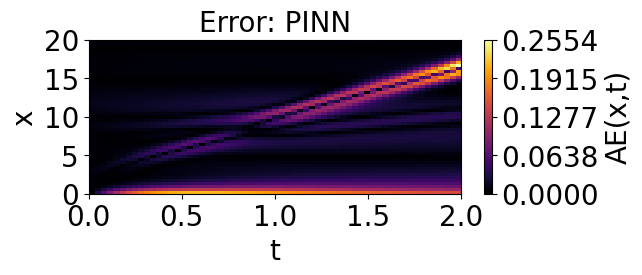

rMAE = 0.004
rRMSE = 0.003
Emax = 0.013


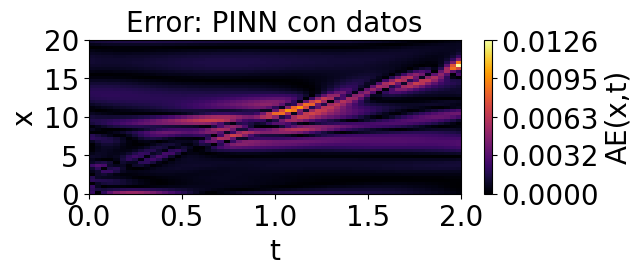

rMAE = 0.166
rRMSE = 0.344
Emax = 5.078


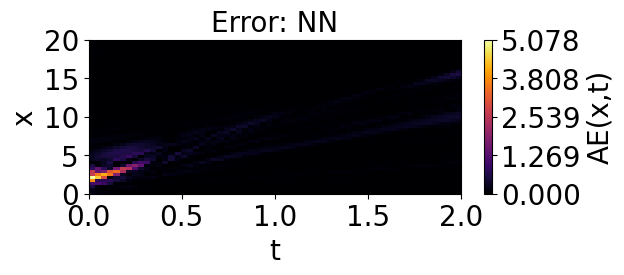

In [ ]:
ErrorHeatMap(np.mean(u_tx_PINN, axis = 0), "PINN")
ErrorHeatMap(np.mean(u_tx_PINN_Datos, axis = 0), "PINN con datos")
ErrorHeatMap(np.mean(u_tx_NN_Datos, axis = 0), "NN")

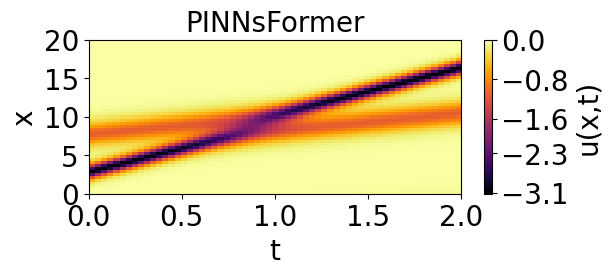

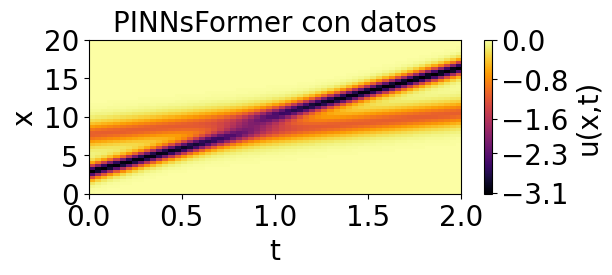

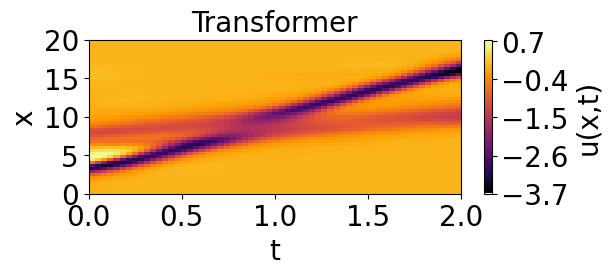

In [ ]:
HeatMap(np.mean(u_tx_PINNsFormer, axis = 0), "PINNsFormer")
HeatMap(np.mean(u_tx_PINNsFormer_Datos, axis = 0), "PINNsFormer con datos")
HeatMap(np.mean(u_tx_Transformer_Datos, axis = 0), "Transformer")

rMAE = 0.004
rRMSE = 0.005
Emax = 0.053


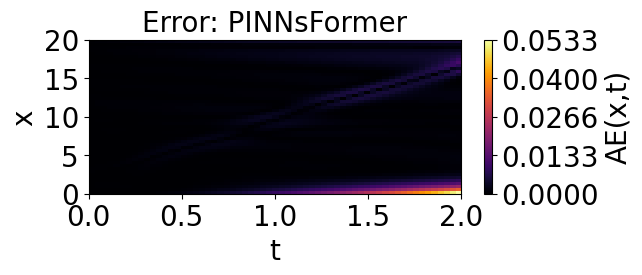

rMAE = 0.000
rRMSE = 0.000
Emax = 0.001


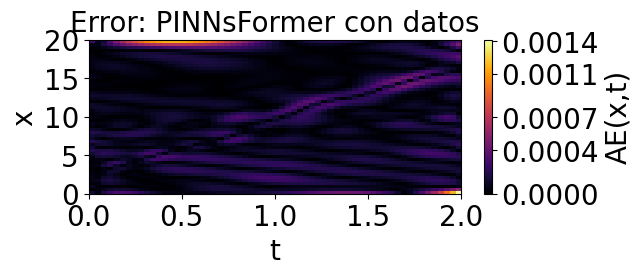

rMAE = 0.113
rRMSE = 0.163
Emax = 1.452


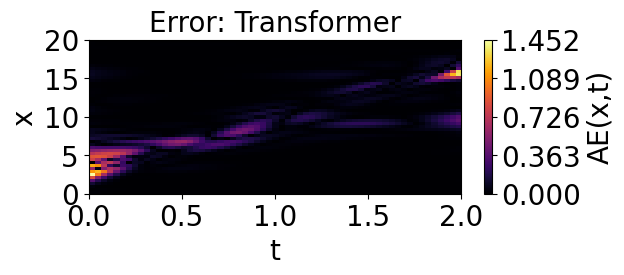

In [ ]:
ErrorHeatMap(np.mean(u_tx_PINNsFormer, axis = 0), "PINNsFormer")
ErrorHeatMap(np.mean(u_tx_PINNsFormer_Datos, axis = 0), "PINNsFormer con datos")
ErrorHeatMap(np.mean(u_tx_Transformer_Datos, axis = 0), "Transformer")

## Animación

In [ ]:
size=25
fig, ax = plt.subplots()
ax.set_xlim(0, L)
ax.set_xlabel('x', fontsize=size)
ax.set_ylabel('u(x,t)', fontsize=size)
ax.set_title("Korteweg-De Vries", fontsize=size)
ax.tick_params(axis='both', which='major', labelsize=size)

# Imagen inicial
line_real, = ax.plot(x, u_tx_real[0])
tiempo_text = ax.text(0.95, 0.95, '', transform=ax.transAxes, ha='right', va='top', fontsize=size)

def actualizar(frame):
  line_real.set_ydata(u_tx_real[frame])
  tiempo_text.set_text(f't: {t[frame]:.1f}')
  return line_real, tiempo_text,

# Actualizar
ani = animation.FuncAnimation(fig, actualizar, frames=Nt, interval=50, blit=True)

# Mostrar la animación en Google Colab
plt.close("all")
HTML(ani.to_jshtml())

In [ ]:
AnimComparacion(np.mean(u_tx_PINN, axis = 0), "PINN")

In [ ]:
AnimComparacion(np.mean(u_tx_PINN_Datos, axis = 0), "PINN con datos")

In [ ]:
AnimComparacion(np.mean(u_tx_NN_Datos, axis = 0), "NN")

In [ ]:
AnimComparacion(np.mean(u_tx_PINNsFormer, axis = 0), "PINNsFormer")

In [ ]:
AnimComparacion(np.mean(u_tx_PINNsFormer_Datos, axis = 0), "PINNsFormer con datos")

In [ ]:
AnimComparacion(np.mean(u_tx_Transformer_Datos, axis = 0), "Transformer")